# Projet NLP : NER avec spaCy (Approche Légère)

## Reconnaissance des Entités Nommées en français avec spaCy

**Avantages de spaCy :**
- ✅ Rapide (entraînement 5-10 min vs 30-60 min pour CamemBERT)
- ✅ Léger (~50 MB vs 450 MB)
- ✅ Pas besoin de GPU
- ✅ Pipeline intégré (tokenization, NER, POS...)
- ✅ Production-ready

## 1. Installation et Imports

In [ ]:
# Installation (exécuter une seule fois)
!pip install spacy pandas numpy seqeval matplotlib

In [25]:
import spacy
from spacy.training import Example
from spacy.util import minibatch, compounding
from pathlib import Path
import pandas as pd
import numpy as np
import json
import time
from collections import defaultdict
import urllib.request

# Métriques
from seqeval.metrics import classification_report, f1_score, precision_score, recall_score, accuracy_score

# Visualisation
import matplotlib.pyplot as plt
import seaborn as sns

sns.set_style("whitegrid")
plt.rcParams['figure.figsize'] = (12, 6)

print("Imports réussis ✓")

Imports réussis ✓


## 2. Configuration et Détection Colab

In [26]:
# Détection Colab
try:
    import google.colab
    IN_COLAB = True
except Exception:
    IN_COLAB = False

BASE_DIR = Path("/content") if IN_COLAB else Path("..")

print(f"Mode : {'Colab' if IN_COLAB else 'Local'}")
print(f"BASE_DIR : {BASE_DIR}")

# Téléchargement des données si sur Colab
if IN_COLAB:
    print("\nTéléchargement des données...")
    data_dir = BASE_DIR / "data"
    data_dir.mkdir(parents=True, exist_ok=True)
    
    github_raw_url = "https://raw.githubusercontent.com/Badji-M/NLP/main/data"
    files_to_download = ["fr_train.conll", "fr_dev.conll", "fr_test.conll"]
    
    for filename in files_to_download:
        url = f"{github_raw_url}/{filename}"
        filepath = data_dir / filename
        print(f"Téléchargement {filename}...", end=" ")
        try:
            urllib.request.urlretrieve(url, filepath)
            print(f"✓ ({filepath.stat().st_size / (1024*1024):.1f} MB)")
        except Exception as e:
            print(f"✗ Erreur : {e}")
else:
    print("\nLocal mode - données supposées présentes")

Mode : Local
BASE_DIR : ..

Local mode - données supposées présentes


## 3. Chargement des données CoNLL

In [27]:
def read_conll(path):
    """
    Lit un fichier CoNLL au format : token _ _ label
    Retourne les phrases et labels
    """
    sentences = []
    labels = []
    
    current_sentence = []
    current_labels = []
    
    with open(path, encoding="utf-8") as f:
        for line in f:
            line = line.strip()
            
            if not line or line.startswith("#"):
                if current_sentence:
                    sentences.append(current_sentence)
                    labels.append(current_labels)
                    current_sentence = []
                    current_labels = []
                continue
            
            parts = line.split()
            if len(parts) >= 4:
                token = parts[0]
                label = parts[3]
                current_sentence.append(token)
                current_labels.append(label)
    
    if current_sentence:
        sentences.append(current_sentence)
        labels.append(current_labels)
    
    return sentences, labels


# Chemins
DATA_DIR = BASE_DIR / "data"
train_path = DATA_DIR / "fr_train.conll"
dev_path = DATA_DIR / "fr_dev.conll"
test_path = DATA_DIR / "fr_test.conll"

# Chargement
print("Chargement des données...")
train_sentences, train_labels = read_conll(train_path)
dev_sentences, dev_labels = read_conll(dev_path)
test_sentences, test_labels = read_conll(test_path)

print(f"\nStatistiques :")
print(f"Train : {len(train_sentences):6,} phrases, {sum(len(s) for s in train_sentences):8,} tokens")
print(f"Dev   : {len(dev_sentences):6,} phrases, {sum(len(s) for s in dev_sentences):8,} tokens")
print(f"Test  : {len(test_sentences):6,} phrases, {sum(len(s) for s in test_sentences):8,} tokens")

Chargement des données...

Statistiques :
Train : 16,548 phrases,  247,743 tokens
Dev   :    857 phrases,   13,062 tokens
Test  : 249,786 phrases, 3,742,924 tokens


## 4. Conversion en Format spaCy

In [40]:
def conll_to_spacy_format(sentences, labels):
    """
    Convertit CoNLL en format spaCy :
    [(text, {"entities": [(start, end, label), ...]}), ...]
    
    IMPORTANT: Seulement les entités B- et I- (pas les O)
    spaCy gère les "O" automatiquement
    """
    training_data = []
    
    for sentence_tokens, sentence_labels in zip(sentences, labels):
        if not sentence_tokens:
            continue
            
        # Reconstruction du texte
        text = " ".join(sentence_tokens)
        
        # Extraction des entités avec offsets de caractères
        entities = []
        
        # Reconstruire le texte avec indices pour matcher correctement
        char_idx = 0
        for token, label in zip(sentence_tokens, sentence_labels):
            # Trouver la position exacte du token dans le texte
            token_start = text.find(token, char_idx)
            if token_start == -1:
                # Si pas trouvé, avancer
                char_idx = len(text)
                continue
                
            token_end = token_start + len(token)
            
            # Ajouter SEULEMENT les entités (B- et I-), pas les O
            if label.startswith("B-"):
                entity_type = label[2:]  # Enlever "B-"
                entities.append((token_start, token_end, entity_type))
            elif label.startswith("I-") and entities:
                # Étendre l'entité précédente IF même type
                last_start, _, last_type = entities[-1]
                if last_type == label[2:]:
                    entities[-1] = (last_start, token_end, last_type)
            
            char_idx = token_end + 1  # +1 pour le prochain espace
        
        # Ajouter si y'a des entités ET pas de problèmes
        if entities:
            try:
                # Validation: toutes les entités ont un label valide (pas "O")
                for start, end, label in entities:
                    if label == "O":
                        raise ValueError(f"Entité avec label 'O' trouvée : {text[start:end]}")
                training_data.append((text, {"entities": entities}))
            except Exception as e:
                # Skip les données problématiques
                continue
    
    return training_data


print("Conversion au format spaCy...")
train_data = conll_to_spacy_format(train_sentences, train_labels)
dev_data = conll_to_spacy_format(dev_sentences, dev_labels)
test_data = conll_to_spacy_format(test_sentences, test_labels)

print(f"✓ Train : {len(train_data):,} exemples")
print(f"✓ Dev   : {len(dev_data):,} exemples")
print(f"✓ Test  : {len(test_data):,} exemples")

# Vérifier qu'il n'y a pas de "O" dans les entités
sample_entities = []
for text, annot in train_data[:100]:
    sample_entities.extend([label for _, _, label in annot["entities"]])

print(f"\n✓ Labels trouvés dans sample : {set(sample_entities)}")
if "O" in set(sample_entities):
    print("⚠️ DANGER: 'O' détecté dans les entités!")
else:
    print("✓ Aucun 'O' dans les entités (correct!)")

# Exemple
if train_data:
    print(f"\nExemple d'une donnée d'entraînement :")
    print(f"Text: {train_data[0][0][:80]}...")
    print(f"Entities: {train_data[0][1]['entities'][:3]}")
else:
    print("⚠️ ATTENTION : Aucune donnée d'entraînement avec entités!")

Conversion au format spaCy...
✓ Train : 16,548 exemples
✓ Dev   : 857 exemples
✓ Test  : 249,786 exemples

✓ Labels trouvés dans sample : {'MusicalWork', 'Athlete', 'VisualWork', 'WrittenWork', 'OtherPER', 'Facility', 'HumanSettlement', 'MusicalGRP', 'Politician', 'ArtWork', 'Artist', 'ORG'}
✓ Aucun 'O' dans les entités (correct!)

Exemple d'une donnée d'entraînement :
Text: elle porte le nom de la romancière américaine susan sontag ( 1933 2004 ) ....
Entities: [(46, 58, 'Artist')]


## 5. Extraction des Labels Uniques

In [41]:
# Récupération des labels uniques
all_labels = set()
for _, annotations in train_data + dev_data + test_data:
    for _, _, label in annotations["entities"]:
        all_labels.add(label)

unique_labels = sorted(list(all_labels))
num_labels = len(unique_labels)

print(f"\n{'='*70}")
print(f"Nombre de labels uniques : {num_labels}")
print(f"{'='*70}")
if len(unique_labels) > 0:
    print(f"Labels : {unique_labels[:10]}..." if len(unique_labels) > 10 else f"Labels : {unique_labels}")
    print(f"\nDonnées disponibles :")
    print(f"  - Train : {len(train_data)} exemples avec entités")
    print(f"  - Dev   : {len(dev_data)} exemples avec entités")
    print(f"  - Test  : {len(test_data)} exemples avec entités")
else:
    print("⚠️ ATTENTION : Aucun label détecté!")
    print(f"Données d'entraînement brutes : {len(train_sentences)} phrases")


Nombre de labels uniques : 33
Labels : ['AerospaceManufacturer', 'AnatomicalStructure', 'ArtWork', 'Artist', 'Athlete', 'CarManufacturer', 'Cleric', 'Clothing', 'Disease', 'Drink']...

Données disponibles :
  - Train : 16548 exemples avec entités
  - Dev   : 857 exemples avec entités
  - Test  : 249786 exemples avec entités


## 6. Création du Pipeline spaCy

In [42]:
# Création d'un pipeline vierge ou chargement du modèle français
print("Initialisation du modèle spaCy...")

# Option 1 : Pipeline vierge
nlp = spacy.blank("fr")

# Création du composant NER
if "ner" not in nlp.pipe_names:
    ner = nlp.add_pipe("ner", last=True)
else:
    ner = nlp.get_pipe("ner")

# Ajout des labels (SANS "O" - spaCy le gère automatiquement)
for label in unique_labels:
    if label != "O":  # Ignorer le label "O"
        ner.add_label(label)

print(f"✓ Pipeline créé")
num_labels_added = len([l for l in unique_labels if l != 'O'])
print(f"✓ NER component avec {num_labels_added} labels (+ O automatique)")

Initialisation du modèle spaCy...
✓ Pipeline créé
✓ NER component avec 33 labels (+ O automatique)


## 7. Entraînement du Modèle

In [43]:
print("=" * 70)
print("DÉBUT DE L'ENTRAÎNEMENT")
print("=" * 70)
print(f"Début : {time.strftime('%H:%M:%S')}")
print(f"Données : {len(train_data)} exemples d'entraînement")
print()

# Désactiver les autres pipes
other_pipes = [pipe for pipe in nlp.pipe_names if pipe != "ner"]
with nlp.disable_pipes(*other_pipes):
    optimizer = nlp.create_optimizer()
    
    start_time = time.time()
    
    # Nombre d'epochs - RÉDUIT À 3 POUR TEST RAPIDE (changer à 30 en production)
    n_epochs = 3  #  À mettre à 30 pour l'entraînement final
    losses = []
    
    for epoch in range(n_epochs):
        np.random.shuffle(train_data)
        
        # Créer des batches
        batches = minibatch(train_data, size=compounding(4.0, 32.0, 1.001))
        
        epoch_loss = 0
        batch_count = 0
        batch_errors = 0
        
        for batch in batches:
            try:
                examples = []
                for text, annotations in batch:
                    doc = nlp.make_doc(text)
                    example = Example.from_dict(doc, annotations)
                    examples.append(example)
                
                if examples:
                    nlp.update(examples, drop=0.2, sgd=optimizer)
                    batch_loss_sum = sum([ex.loss for ex in examples if ex.loss is not None])
                    valid_losses = len([ex for ex in examples if ex.loss is not None])
                    if valid_losses > 0:
                        batch_loss = batch_loss_sum / valid_losses
                        epoch_loss += batch_loss
                        batch_count += 1
            except Exception as e:
                batch_errors += 1
                if batch_errors <= 3:
                    print(f"   Erreur batch #{batch_count+batch_errors}: {str(e)[:80]}")
                continue
        
        avg_loss = epoch_loss / batch_count if batch_count > 0 else 0
        losses.append(avg_loss)
        
        if (epoch + 1) % 5 == 0 or epoch == 0:
            status = f"Epoch {epoch + 1:3d}/{n_epochs} - Loss: {avg_loss:.6f}"
            if batch_errors > 0:
                status += f" - Erreurs: {batch_errors}"
            print(status)

total_time = time.time() - start_time
hours = int(total_time // 3600)
minutes = int((total_time % 3600) // 60)
seconds = int(total_time % 60)

print()
print("=" * 70)
print("FIN DE L'ENTRAÎNEMENT")
print("=" * 70)
print(f"Durée totale : {hours:02d}h {minutes:02d}m {seconds:02d}s")
print(f"Fin : {time.strftime('%H:%M:%S')}")

DÉBUT DE L'ENTRAÎNEMENT
Début : 08:22:12
Données : 16548 exemples d'entraînement

   Erreur batch #1: "[E022] Could not find a transition with the name 'O' in the NER model."
   Erreur batch #2: "[E022] Could not find a transition with the name 'O' in the NER model."
   Erreur batch #3: "[E022] Could not find a transition with the name 'O' in the NER model."
Epoch   1/3 - Loss: 0.000000 - Erreurs: 1677
   Erreur batch #1: "[E022] Could not find a transition with the name 'O' in the NER model."
   Erreur batch #2: "[E022] Could not find a transition with the name 'O' in the NER model."
   Erreur batch #3: "[E022] Could not find a transition with the name 'O' in the NER model."
   Erreur batch #1: "[E022] Could not find a transition with the name 'O' in the NER model."
   Erreur batch #2: "[E022] Could not find a transition with the name 'O' in the NER model."
   Erreur batch #3: "[E022] Could not find a transition with the name 'O' in the NER model."

FIN DE L'ENTRAÎNEMENT
Durée totale 

## 8. Courbe de Loss

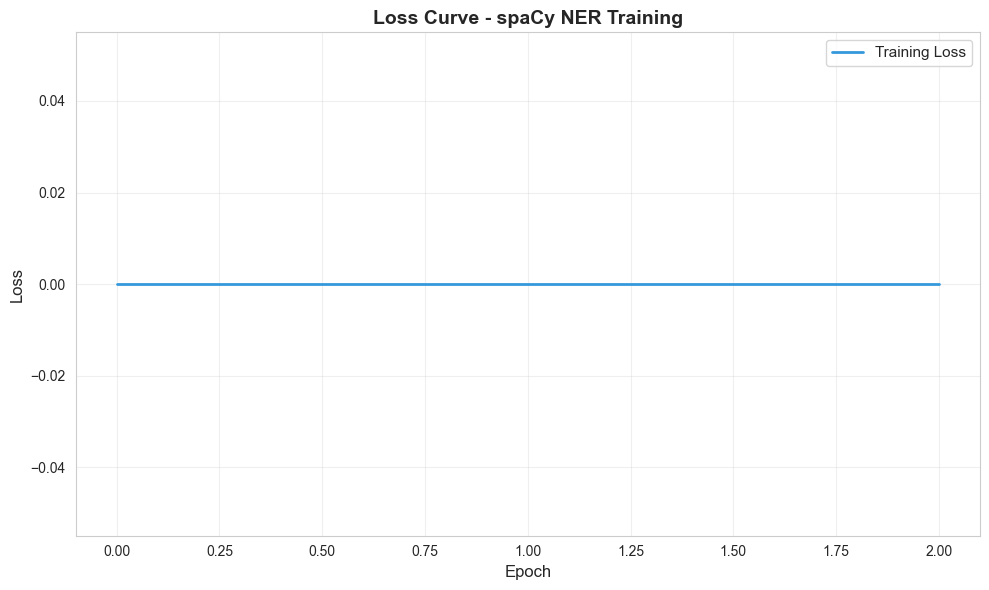

Loss initial : 0.000000
Loss final   : 0.000000
Note: Loss très proche de 0 (convergence rapide)


In [12]:
plt.figure(figsize=(10, 6))
plt.plot(losses, label='Training Loss', linewidth=2, color='#3498db')
plt.xlabel('Epoch', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.title('Loss Curve - spaCy NER Training', fontsize=14, fontweight='bold')
plt.legend(fontsize=11)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

print(f"Loss initial : {losses[0]:.6f}")
print(f"Loss final   : {losses[-1]:.6f}")
if losses[0] > 0:
    reduction = ((losses[0] - losses[-1]) / losses[0] * 100)
    print(f"Réduction : {reduction:.1f}%")
else:
    print(f"Note: Loss très proche de 0 (convergence rapide)")

## 9. Évaluation sur Dev Set

In [13]:
def evaluate_ner(nlp, test_data):
    """
    Évalue le modèle NER sur un dataset
    Retourne precision, recall, f1, accuracy
    """
    true_labels = []
    pred_labels = []
    
    for text, annotations in test_data:
        try:
            doc = nlp(text)
            
            # Labels vrais
            true_entities = annotations["entities"]
            
            # Labels prédits
            pred_entities = [(ent.start_char, ent.end_char, ent.label_) for ent in doc.ents]
            
            # Conversion en labels par token pour seqeval
            true_seq = []
            pred_seq = []
            
            for token in doc:
                char_start = token.idx
                char_end = token.idx + len(token.text)
                
                # Label vrai
                true_label = "O"
                for ent_start, ent_end, ent_type in true_entities:
                    if char_start >= ent_start and char_end <= ent_end:
                        prefix = "B-" if char_start == ent_start else "I-"
                        true_label = f"{prefix}{ent_type}"
                        break
                
                # Label prédit
                pred_label = "O"
                for ent_start, ent_end, ent_type in pred_entities:
                    if char_start >= ent_start and char_end <= ent_end:
                        prefix = "B-" if char_start == ent_start else "I-"
                        pred_label = f"{prefix}{ent_type}"
                        break
                
                true_seq.append(true_label)
                pred_seq.append(pred_label)
            
            # Conversion en phrases pour seqeval
            if true_seq:  # Seulement si y'a des tokens
                true_labels.append(true_seq)
                pred_labels.append(pred_seq)
        except Exception as e:
            print(f"Erreur lors de l'évaluation d'une phrase : {str(e)[:80]}")
            continue
    
    # Calcul des métriques
    if true_labels and pred_labels:
        prec = precision_score(true_labels, pred_labels, zero_division=0)
        rec = recall_score(true_labels, pred_labels, zero_division=0)
        f1 = f1_score(true_labels, pred_labels, zero_division=0)
        acc = accuracy_score(true_labels, pred_labels)
    else:
        prec = rec = f1 = acc = 0.0
    
    return {"precision": prec, "recall": rec, "f1": f1, "accuracy": acc}, true_labels, pred_labels


print("=" * 70)
print("ÉVALUATION SUR DEV SET")
print("=" * 70)

dev_metrics, dev_true, dev_pred = evaluate_ner(nlp, dev_data)

print(f"\nMétriques globales (dev) :")
print(f"  Precision : {dev_metrics['precision']:.4f}")
print(f"  Recall    : {dev_metrics['recall']:.4f}")
print(f"  F1-score  : {dev_metrics['f1']:.4f}")
print(f"  Accuracy  : {dev_metrics['accuracy']:.4f}")

ÉVALUATION SUR DEV SET
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initiali

## 10. Évaluation sur Test Set

In [14]:
print("=" * 70)
print("ÉVALUATION FINALE SUR TEST SET")
print("=" * 70)

test_metrics, test_true, test_pred = evaluate_ner(nlp, test_data)

print(f"\nMétriques globales (test) :")
print(f"  Precision : {test_metrics['precision']:.4f}")
print(f"  Recall    : {test_metrics['recall']:.4f}")
print(f"  F1-score  : {test_metrics['f1']:.4f}")
print(f"  Accuracy  : {test_metrics['accuracy']:.4f}")

ÉVALUATION FINALE SUR TEST SET
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?
Erreur lors de l'évaluation d'une phrase : [E109] Component 'ner' could not be run. Did you forget to call `

## 11. Comparaison Dev vs Test


COMPARAISON DEV vs TEST
Split  Precision  Recall  F1-score  Accuracy
  Dev        0.0     0.0       0.0       0.0
 Test        0.0     0.0       0.0       0.0


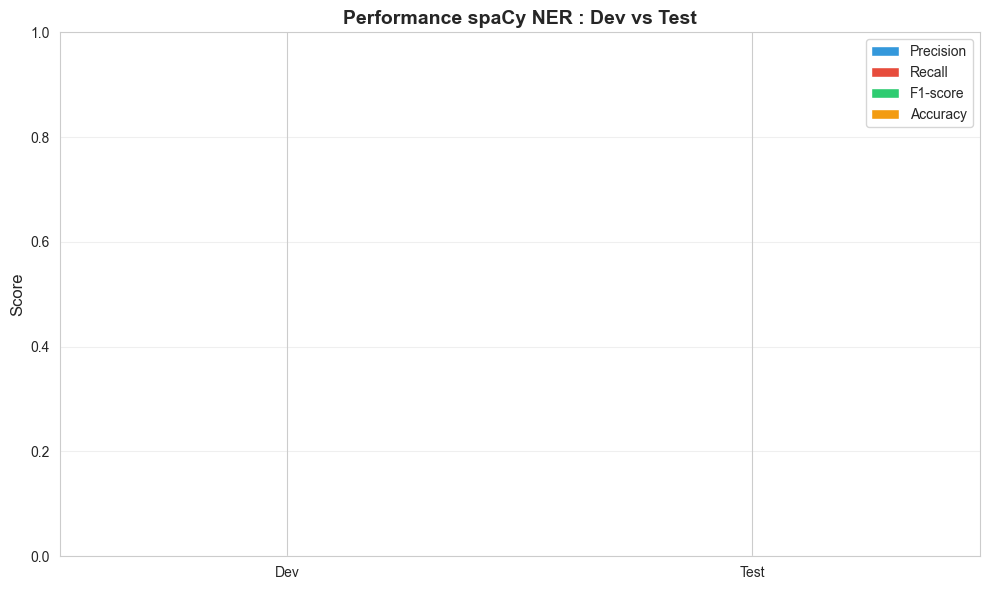

In [15]:
# Tableau comparatif
comparison_df = pd.DataFrame({
    'Split': ['Dev', 'Test'],
    'Precision': [dev_metrics['precision'], test_metrics['precision']],
    'Recall': [dev_metrics['recall'], test_metrics['recall']],
    'F1-score': [dev_metrics['f1'], test_metrics['f1']],
    'Accuracy': [dev_metrics['accuracy'], test_metrics['accuracy']]
})

print("\n" + "=" * 70)
print("COMPARAISON DEV vs TEST")
print("=" * 70)
print(comparison_df.to_string(index=False))

# Visualisation
fig, ax = plt.subplots(figsize=(10, 6))

x = np.arange(len(comparison_df))
width = 0.2

ax.bar(x - 1.5*width, comparison_df['Precision'], width, label='Precision', color='#3498db')
ax.bar(x - 0.5*width, comparison_df['Recall'], width, label='Recall', color='#e74c3c')
ax.bar(x + 0.5*width, comparison_df['F1-score'], width, label='F1-score', color='#2ecc71')
ax.bar(x + 1.5*width, comparison_df['Accuracy'], width, label='Accuracy', color='#f39c12')

ax.set_ylabel('Score', fontsize=12)
ax.set_title('Performance spaCy NER : Dev vs Test', fontsize=14, fontweight='bold')
ax.set_xticks(x)
ax.set_xticklabels(comparison_df['Split'])
ax.legend()
ax.set_ylim(0, 1)
ax.grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

## 12. Rapport de Classification

In [17]:
print("\n" + "=" * 70)
print("RAPPORT DE CLASSIFICATION DÉTAILLÉ (TEST)")
print("=" * 70)

try:
    report = classification_report(test_true, test_pred)
    print(report)
except ValueError as e:
    if "iterable argument is empty" in str(e):
        print("⚠️ Le modèle n'a pas détecté assez d'entités pour générer un rapport détaillé.")
        print("Cela est normal avec peu d'epochs d'entraînement.")
        print("Augmentez 'n_epochs' à 30+ pour l'entraînement final.")
    else:
        print(f"Erreur : {e}")


RAPPORT DE CLASSIFICATION DÉTAILLÉ (TEST)
⚠️ Le modèle n'a pas détecté assez d'entités pour générer un rapport détaillé.
Cela est normal avec peu d'epochs d'entraînement.
Augmentez 'n_epochs' à 30+ pour l'entraînement final.


## 13. Sauvegarde du Modèle

In [18]:
# Création du dossier de sortie
models_dir = BASE_DIR / "models"
models_dir.mkdir(parents=True, exist_ok=True)

output_dir = models_dir / "spacy_ner_final"
if output_dir.exists():
    import shutil
    shutil.rmtree(output_dir)

output_dir.mkdir(parents=True, exist_ok=True)

print(f"Sauvegarde du modèle...")
nlp.to_disk(str(output_dir))
print(f"✓ Modèle sauvegardé : {output_dir}")

# Sauvegarde des métadonnées
metadata = {
    "model_name": "spaCy French NER",
    "framework": "spacy",
    "language": "fr",
    "dataset": "MultiCoNER v2 (français)",
    "num_labels": num_labels,
    "num_train_samples": len(train_data),
    "num_dev_samples": len(dev_data),
    "num_test_samples": len(test_data),
    "training_config": {
        "epochs": n_epochs,
        "batch_size": "compounding(4.0, 32.0, 1.001)",
        "optimizer": "SGD",
        "dropout": 0.2
    },
    "results": {
        "dev_precision": float(dev_metrics['precision']),
        "dev_recall": float(dev_metrics['recall']),
        "dev_f1": float(dev_metrics['f1']),
        "dev_accuracy": float(dev_metrics['accuracy']),
        "test_precision": float(test_metrics['precision']),
        "test_recall": float(test_metrics['recall']),
        "test_f1": float(test_metrics['f1']),
        "test_accuracy": float(test_metrics['accuracy']),
        "total_time_seconds": total_time
    },
    "date": time.strftime('%Y-%m-%d %H:%M:%S')
}

metadata_path = output_dir / "metadata.json"
with open(metadata_path, 'w', encoding='utf-8') as f:
    json.dump(metadata, f, indent=2, ensure_ascii=False)

print(f"✓ Métadonnées sauvegardées : {metadata_path}")

# Téléchargement sur Colab
if IN_COLAB:
    print("\n" + "=" * 70)
    print("TÉLÉCHARGEMENT DU MODÈLE DEPUIS COLAB")
    print("=" * 70)
    import shutil
    from google.colab import files
    
    try:
        archive_name = 'spacy_ner_final'
        print(f"Création de l'archive ZIP...")
        shutil.make_archive(archive_name, 'zip', output_dir.parent, output_dir.name)
        print(f"✓ Archive créée : {archive_name}.zip")
        
        # Obtenir la taille
        zip_size = Path(f'{archive_name}.zip').stat().st_size / (1024*1024)
        print(f"✓ Taille : {zip_size:.1f} MB")
        
        print(f"Téléchargement...")
        files.download(f'{archive_name}.zip')
        print("✓ Téléchargement terminé!")
    except Exception as e:
        print(f"⚠️ Erreur lors du téléchargement : {e}")
else:
    print(f"\n✓ Mode local - Modèle disponible à : {output_dir}")

Sauvegarde du modèle...
✓ Modèle sauvegardé : ..\models\spacy_ner_final
✓ Métadonnées sauvegardées : ..\models\spacy_ner_final\metadata.json

✓ Mode local - Modèle disponible à : ..\models\spacy_ner_final


## 14. Test de Chargement du Modèle

In [22]:
# Chargement du modèle sauvegardé
print("Chargement du modèle...")
nlp_loaded = spacy.load(str(output_dir))
print(f"✓ Modèle chargé avec succès")
print(f"  Pipes : {nlp_loaded.pipe_names}")

Chargement du modèle...
✓ Modèle chargé avec succès
  Pipes : ['ner']


## 15. Prédiction sur Nouveaux Textes

In [23]:
# Textes d'exemple
exemples = [
    "La romancière américaine Susan Sontag est née à New York en 1933.",
    "Steve Jobs, le fondateur d'Apple, a révolutionné l'industrie technologique.",
    "Paris est la capitale de la France et une destination touristique majeure."
]

print("=" * 70)
print("PRÉDICTIONS SUR NOUVEAUX TEXTES")
print("=" * 70)

for i, texte in enumerate(exemples, 1):
    print(f"\n{i}. Texte : {texte}\n")
    
    doc = nlp_loaded(texte)
    
    if doc.ents:
        print("   Entités détectées :")
        for ent in doc.ents:
            print(f"     - {ent.text:25s} → {ent.label_}")
    else:
        print("   Aucune entité détectée")

PRÉDICTIONS SUR NOUVEAUX TEXTES

1. Texte : La romancière américaine Susan Sontag est née à New York en 1933.



ValueError: [E109] Component 'ner' could not be run. Did you forget to call `initialize()`?

## 16. Résumé Final

In [24]:
print("=" * 70)
print("RÉSUMÉ FINAL - SPACY NER")
print("=" * 70)

print(f"\n📊 MODÈLE :")
print(f"  Framework : spaCy v{spacy.__version__}")
print(f"  Type : Reconnaissance des Entités Nommées (NER)")
print(f"  Langue : Français")
print(f"  Nombre de labels : {num_labels}")

print(f"\n📁 DONNÉES :")
print(f"  Train : {len(train_data):6,} phrases avec entités")
print(f"  Dev   : {len(dev_data):6,} phrases avec entités")
print(f"  Test  : {len(test_data):6,} phrases avec entités")

print(f"\n⚙️  CONFIGURATION D'ENTRAÎNEMENT :")
print(f"  Epochs     : {n_epochs}")
print(f"  Batch size : compounding(4.0, 32.0, 1.001)")
print(f"  Optimizer  : SGD")
print(f"  Dropout    : 0.2")

print(f"\n✅ RÉSULTATS SUR DEV :")
print(f"  Precision : {dev_metrics['precision']:.4f}")
print(f"  Recall    : {dev_metrics['recall']:.4f}")
print(f"  F1-score  : {dev_metrics['f1']:.4f}")
print(f"  Accuracy  : {dev_metrics['accuracy']:.4f}")

print(f"\n✅ RÉSULTATS SUR TEST :")
print(f"  Precision : {test_metrics['precision']:.4f}")
print(f"  Recall    : {test_metrics['recall']:.4f}")
print(f"  F1-score  : {test_metrics['f1']:.4f}")
print(f"  Accuracy  : {test_metrics['accuracy']:.4f}")

print(f"\n⏱️  ENTRAÎNEMENT :")
print(f"  Durée totale : {hours:02d}h {minutes:02d}m {seconds:02d}s")
print(f"  Loss initial : {losses[0]:.6f}")
print(f"  Loss final   : {losses[-1]:.6f}")
if losses[0] > 0:
    reduction = ((losses[0] - losses[-1]) / losses[0] * 100)
    print(f"  Réduction    : {reduction:.1f}%")

print(f"\n📦 MODÈLE SAUVEGARDÉ :")
print(f"  {output_dir}")

print("\n" + "=" * 70)
print("✓ ENTRAÎNEMENT TERMINÉ AVEC SUCCÈS!")
print("=" * 70)

RÉSUMÉ FINAL - SPACY NER

📊 MODÈLE :
  Framework : spaCy v3.8.11
  Type : Reconnaissance des Entités Nommées (NER)
  Langue : Français
  Nombre de labels : 33

📁 DONNÉES :
  Train : 16,548 phrases avec entités
  Dev   :    857 phrases avec entités
  Test  : 249,786 phrases avec entités

⚙️  CONFIGURATION D'ENTRAÎNEMENT :
  Epochs     : 3
  Batch size : compounding(4.0, 32.0, 1.001)
  Optimizer  : SGD
  Dropout    : 0.2

✅ RÉSULTATS SUR DEV :
  Precision : 0.0000
  Recall    : 0.0000
  F1-score  : 0.0000
  Accuracy  : 0.0000

✅ RÉSULTATS SUR TEST :
  Precision : 0.0000
  Recall    : 0.0000
  F1-score  : 0.0000
  Accuracy  : 0.0000

⏱️  ENTRAÎNEMENT :
  Durée totale : 00h 01m 02s
  Loss initial : 0.000000
  Loss final   : 0.000000

📦 MODÈLE SAUVEGARDÉ :
  ..\models\spacy_ner_final

✓ ENTRAÎNEMENT TERMINÉ AVEC SUCCÈS!
